In [1]:
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import torch
import torch.nn as nn
from torch.autograd import Variable
import torch.nn.functional as F
import torch.optim as optim

In [3]:
from torchvision import datasets, models, transforms
from utils import view_data
from typing import List, Tuple

In [4]:
from easydict import EasyDict as edict

In [5]:
args = edict({})
args.image_size = 240
args.batch_size = 25
args.log_interval = 100

In [6]:
# normalization used to train VGG
# see https://pytorch.org/hub/pytorch_vision_vgg/
v_mean = np.array([0.485, 0.456, 0.406])
v_std = np.array([0.229, 0.224, 0.225])
transforms_norm = transforms.Normalize(mean=v_mean, std=v_std) # to normalize colors on the imagenet dataset



In [7]:
transform_base =  transforms.Compose([
            transforms.Resize((int(args.image_size), int(args.image_size))),
            transforms.ToTensor(),  # Convert the image to pyTorch Tensor data type.
            transforms_norm, ])      
    

In [8]:
image_path = "../data/animal/"

image_dataset = { 'train' : datasets.ImageFolder(
                            image_path+'train',
                            transform=transform_base
                        ),
                  'test' : datasets.ImageFolder(
                            image_path+'test',
                          transform=transform_base
                        )
                }

In [9]:
num_workers = 1

dataloader = { 'train' : torch.utils.data.DataLoader(
                            image_dataset['train'], batch_size=args.batch_size,
                            shuffle=True, 
                            num_workers=num_workers,
                        ),
               'test' : torch.utils.data.DataLoader(
                            image_dataset['test'], batch_size=args.batch_size,
                            shuffle=True, 
                            num_workers=num_workers,
                        )
             }

In [92]:
data, label = next(iter(dataloader['train']))

In [93]:
data.shape

torch.Size([25, 3, 240, 240])

In [94]:
def img_denorm(img, mean, std):
    #for ImageNet the mean and std are:
    #mean = np.asarray([ 0.485, 0.456, 0.406 ])
    #std = np.asarray([ 0.229, 0.224, 0.225 ])

    denormalize = transforms.Normalize((-1 * mean / std), (1.0 / std))

    res = img.squeeze(0)
    res = denormalize(res)

    #Image needs to be clipped since the denormalize function will map some
    #values below 0 and above 1
    res = torch.clamp(res, 0, 1)
    
    return(res)

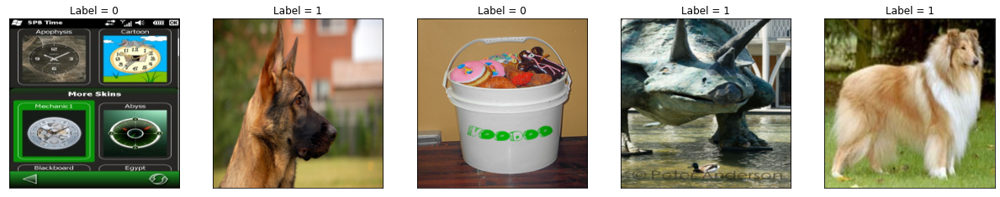

In [95]:
from utils import view_data
for i in range(len(data)):
    data[i] = img_denorm(data[i], v_mean, v_std)
original = view_data(data, label, 5)

In [91]:
len(data)

10

In [13]:
def expand_dim(tensor, dim, desired_dim_len):
    sz = list(tensor.size())
    sz[dim]=desired_dim_len
    return tensor.expand(tuple(sz))

In [14]:
def kl_divergence(model, z):
    # --------------------------
    # Monte carlo KL divergence
    # --------------------------
    # 1. define the first two probabilities (in this case Normal for both)
    p = torch.distributions.Normal(torch.zeros_like(z), args.std_sched  * torch.ones_like(z))

    # 2. get the probabilities from the equation
    log_qzx = model.q.log_prob(z)
    log_pz = p.log_prob(z)

    # kl
    kl = (log_qzx - log_pz)
    
    # sum over last dim to go from single dim distribution to multi-dim
    kl = model.LAMBDA * kl.sum()
    return kl

In [15]:
class Grid_AttentionTransNet(nn.Module):
    
    def __init__(self, do_stn=True, LAMBDA=.1, deterministic=False):
        super(Grid_AttentionTransNet, self).__init__()
        
        self.do_stn = do_stn
        self.deterministic = deterministic
        self.LAMBDA = LAMBDA
        
        self.vgg = models.vgg16(pretrained=True) 
        self.vgg_where = models.vgg16(pretrained=True) 
        
        ##  The what pathway
        
        self.num_features = self.vgg.classifier[-1].in_features
        features = list(self.vgg.classifier.children())[:-1] # Remove last layer
        #features.extend([nn.Linear(num_features, 500)]) # Add our layer
        self.vgg.classifier = nn.Sequential(*features) # Replace the model classifier
        
        self.what_grid = self.logPolarGrid(-1,-4) 
        
        n_features = torch.tensor(self.num_features, dtype=torch.float)
        
        self.fc_what = nn.Linear(self.num_features, 2)
        self.fc_what.weight.data /= torch.sqrt(n_features)
        self.fc_what.bias.data /= torch.sqrt(n_features)

        ##  The where pathway        
        self.num_features = self.vgg_where.classifier[-1].in_features
        features = list(self.vgg_where.classifier.children())[:-1] # Remove last layer
        #features.extend([nn.Linear(num_features, 500)]) # Add our layer
        self.vgg_where.classifier = nn.Sequential(*features) # Replace the model classifier
        
        self.where_grid = self.logPolarGrid(0,-3)
        
        self.mu = nn.Linear(self.num_features, 2) #, bias=False)
        self.logvar = nn.Linear(self.num_features, 2) #, bias=False)
        
        self.mu.weight.data /= torch.sqrt(n_features) 
        self.mu.bias.data /= torch.sqrt(n_features)
        
        self.logvar.weight.data /= torch.sqrt(n_features)
        self.logvar.bias.data /= torch.sqrt(n_features)

        self.downscale = nn.Parameter(torch.tensor([[1, 0], [0, 1]],
                                                   dtype=torch.float),
                                      requires_grad=False)
        self.dropout = torch.nn.Dropout()
    
    def logPolarGrid(self, a, b, base=2):
        rs = torch.logspace(a, b, args.image_size, base = base)
        ts = torch.linspace(0, torch.pi*2, args.image_size)
        
        grid_xs = torch.outer(rs, torch.cos(ts)) 
        grid_xs = grid_xs.unsqueeze(0).unsqueeze(3)
        grid_xs = Variable(grid_xs, requires_grad=False)

        grid_ys = torch.outer(rs, torch.sin(ts)) 
        grid_ys = grid_ys.unsqueeze(0).unsqueeze(3)
        grid_ys = Variable(grid_ys,  requires_grad=False)
        
        grid = torch.cat((grid_xs, grid_ys), 3)
        grid = expand_dim(grid, 0, args.batch_size)
        
        return grid.to(device)    

    def stn(self: object, x: torch.Tensor) -> Tuple[torch.Tensor]:
    
        logPolx = x #F.grid_sample(x, self.where_grid)
        
        if self.do_stn:
            if True: #
                with torch.no_grad():
                    y = self.vgg_where(logPolx)
                mu = self.mu(y)
                                   
                if self.deterministic:
                    self.q = torch.distributions.Normal(mu, .1 * torch.ones_like(mu))  
                    z = mu
                else:
                    logvar = self.logvar(y) + 1
                    sigma = torch.exp(-logvar / 2)
                    self.q = torch.distributions.Normal(mu, sigma)      
                    z = self.q.rsample()
            print(z[0,...])
            theta = torch.cat((self.downscale.unsqueeze(0).repeat(
                                z.size(0), 1, 1), z.unsqueeze(2)),
                                  dim=2)
        
            grid_size = torch.Size([x.size()[0], x.size()[1], args.image_size, args.image_size])
            grid = F.affine_grid(theta, grid_size)
            x = F.grid_sample(x, grid)

        else:
            theta = nn.Parameter(torch.tensor([[1, 0, 0], [0, 1, 0]],
                                                   dtype=torch.float),
                                      requires_grad=False)
            theta = theta.unsqueeze(0).repeat(x.size()[0], 1, 1)
            z = torch.tensor([0, 0],dtype=torch.float)
            z = z.unsqueeze(0).repeat(x.size()[0], 1)
           
        return x, theta, z

    def forward(self, x):
        # transform the input
        x, theta, z = self.stn(x)
        
        logPolx = F.grid_sample(x, self.what_grid)
        if True: #with torch.no_grad():
            y = self.vgg(logPolx)  
        y = self.fc_what(y)
       
        return y, theta, z

In [16]:
def train(epoch, loader):
    model.train()
    for batch_idx, (data, target) in enumerate(loader):
        data, target = data.to(device, dtype=torch.float), target.to(device)

        optimizer.zero_grad()
        output, theta, z = model(data)
        if model.do_stn and not model.deterministic:
            loss = loss_func(output, target) + kl_divergence(model, z)
        else:
            loss = loss_func(output, target)
        loss.backward()
        optimizer.step()
        if True: #batch_idx % args.log_interval == 0:
            print('Train Epoch: {}/{} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, args.epochs, batch_idx * len(data),
                len(dataloader['train'].dataset),
                100. * batch_idx / len(dataloader['train']), loss.item()))


def test(loader):
    with torch.no_grad():
        model.eval()
        test_loss = 0
        correct = 0
        for data, target in loader:
            data, target = data.to(device, dtype=torch.float), target.to(device)

            output, theta, z = model(data)

            # sum up batch loss
            #test_loss += F.nll_loss(output, target, size_average=False).item()
            test_loss += loss_func(output, target).item()
            # get the index of the max log-probability
            #pred = output.max(1, keepdim=True)[1]
            pred = output.argmax(dim=1, keepdim=True)
            correct += pred.eq(target.view_as(pred)).sum().item()

        test_loss /= len(dataloader['test'].dataset)
        print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.
              format(test_loss, correct, len(dataloader['test'].dataset),
                     100. * correct / len(dataloader['test'].dataset)))
        return correct / len(dataloader['test'].dataset)

In [17]:
lr = 1e-4
LAMBDA = 1e-6
do_stn=True
deterministic=True

In [18]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#model = torch.load("../models/low_comp_polo_stn.pt")
model = Grid_AttentionTransNet(do_stn=do_stn, deterministic=deterministic).to(device)

In [39]:
path = 'runs/'
f_prefix = "230107b_logPolarGrid_vgg_stn_True_0.01_0.1"
#f_prefix = '230105b2_logPolarGrid_vgg_stn_True_0.1_0.1'

In [42]:
model = torch.load(f"{path}{f_prefix}.pt", map_location=device)

In [43]:
model.eval()

Grid_AttentionTransNet(
  (vgg): VGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=True)

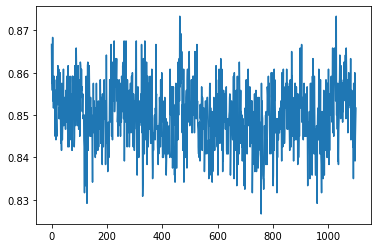

In [40]:
acc = np.load(f"{path}{f_prefix}_acc.npy")
plt.plot(acc)

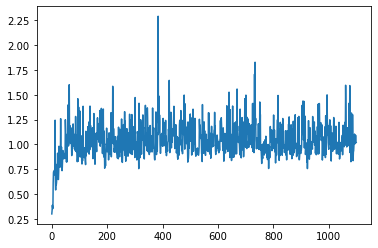

In [41]:
kl_loss = np.load(f"{path}{f_prefix}_kl_loss.npy")
plt.plot(acc)
plt.plot(kl_loss)

In [56]:
data, target = next(iter(dataloader['train']))

In [57]:
with torch.no_grad():
    cat, theta, z = model(data.to(device))
cat = torch.argmax(F.softmax(cat),1)

tensor([ 0.0738, -0.2616])


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
data, target, cat, theta, z = [[]]*10, [[]]*10, [[]]*10, [[]]*10, [[]]*10
center = args.image_size / 2 - 0.5 #np.array([a, args.image_size/2-0.5])
h_width = args.image_size / 2

for i in range(10):
    data[i], target[i] = next(iter(dataloader['train']))
    with torch.no_grad():
        c, theta[i], z[i] = model(data[i].to(device))
    cat[i] = torch.argmax(F.softmax(c),1)
    for j in range(len(data[i])):
        data[i][j] = img_denorm(data[i][j], v_mean, v_std)

tensor([-0.1171, -0.1070])


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  if __name__ == '__main__':
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input d

tensor([-0.0721,  0.1038])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

tensor([ 0.1374, -0.1719])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

tensor([ 0.2189, -0.4426])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

tensor([-0.0632, -0.0510])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

tensor([-0.1272, -0.3533])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

tensor([-0.1899, -0.2052])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

tensor([-0.2512,  0.1072])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

tensor([-0.1906,  0.0103])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

tensor([ 0.1153, -0.0188])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

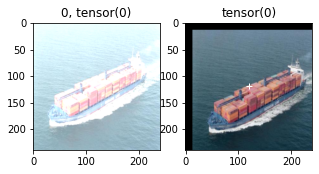

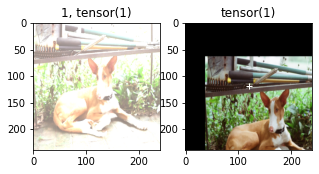

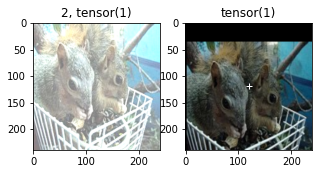

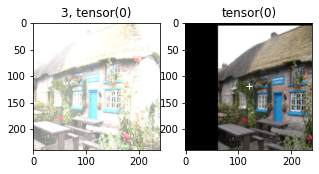

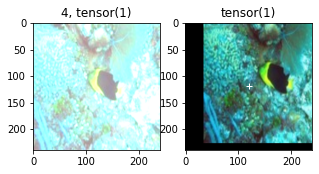

...

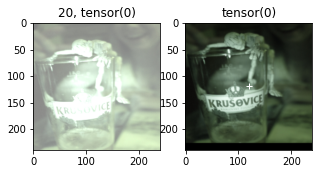

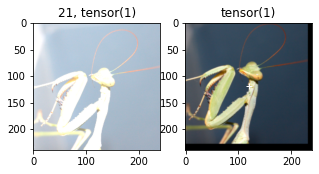

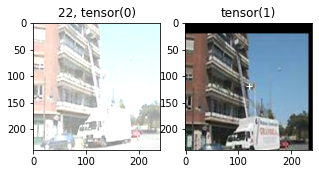

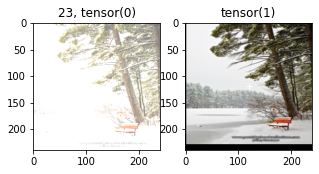

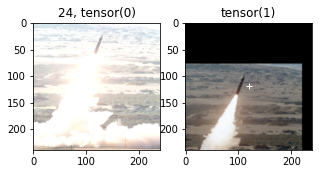

In [96]:
data, target, cat, theta, z = [[]]*10, [[]]*10, [[]]*10, [[]]*10, [[]]*10
center = args.image_size / 2 - 0.5 #np.array([a, args.image_size/2-0.5])
h_width = args.image_size / 2

for i in range(10):

    for num in range(args.batch_size):
        plt.figure(figsize=(5,10))
        plt.subplot(1,2,1)
        img = data[i][num:num+1,...]   
        th = theta[i][num:num+1,...]
        #theta[0,:,2] = torch.FloatTensor((0,.5))
        #print(th)
        grid_size = torch.Size([1, 3, 240, 240])
        grid = F.affine_grid(th, grid_size)
        img_grid = F.grid_sample(img, grid)
        plt.imshow(data[i][num,...].permute(1,2,0).detach().numpy())
        plt.title(str(num)+', '+str(target[i][num]))
        plt.subplot(1,2,2)
        plt.imshow(img_grid[0,:].permute(1,2,0).detach().numpy())
        plt.plot(center, center,'w+')
        plt.title(cat[i][num])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


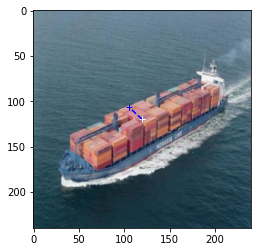

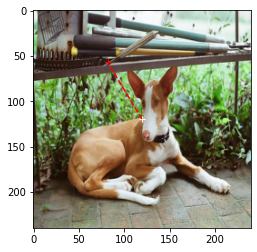

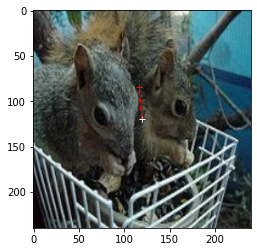

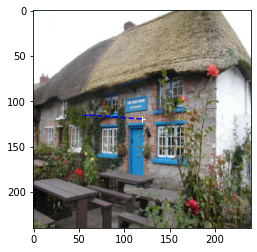

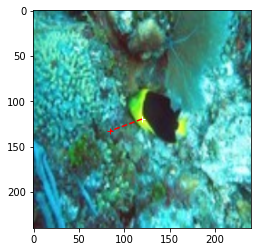

...

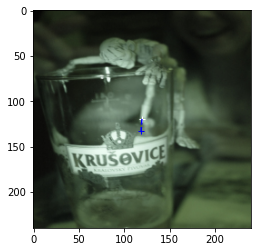

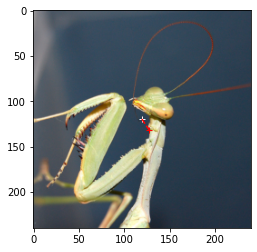

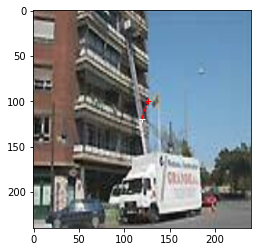

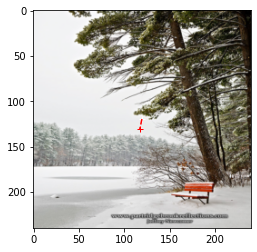

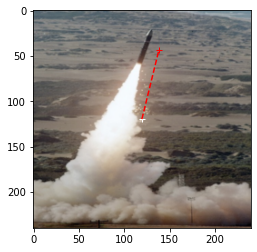

In [97]:
for i in range(10):
    for num in range(args.batch_size):
        plt.figure()
        plt.imshow((data[i][num,...].permute(1,2,0).detach().numpy()))
        plt.plot(center,center,'w+')
        if cat[i][num] == 1:
            plt.plot(center + z[i][num][0]*h_width, center + z[i][num][1]*h_width,'r+')
            plt.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'r--')
        else:
            plt.plot(center + z[i][num][0]*h_width, center + z[i][num][1]*h_width,'b+')
            plt.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'b--')


(0.0, 240.0)

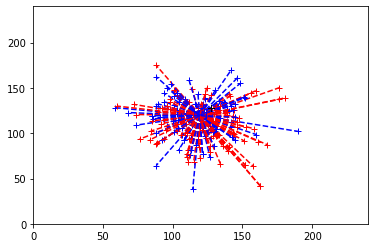

In [80]:
#data, target, cat, theta, z = [[]]*10, [[]]*10, [[]]*10, [[]]*10, [[]]*10
#center = args.image_size / 2 - 0.5 #np.array([a, args.image_size/2-0.5])
#h_width = args.image_size / 2

for i in range(10):
    for num in range(args.batch_size):
        plt.plot(127.5,127.5,'k+')
        if cat[i][num] == 1:
            plt.plot(center + z[i][num][0]*h_width, center + z[i][num][1]*h_width,'r+')
            plt.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'r--')
        else:
            plt.plot(center + z[i][num][0]*h_width, center + z[i][num][1]*h_width,'b+')
            plt.plot([center, center + z[i][num][0]*h_width], [center, center +z[i][num][1]*h_width],'b--')
plt.xlim(0,args.image_size)
plt.ylim(0,args.image_size)

In [75]:
center

array([119.5, 119.5])